In [1]:
!pip install ultralytics --no-deps

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.7 MB/s eta 0:00:00


In [2]:
import pandas as pd
import os
import cv2
import shutil
from pathlib import Path
import random
from sklearn.model_selection import train_test_split
from ultralytics import YOLO
import matplotlib.pyplot as plt
import seaborn as sns

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
df = pd.read_csv('/kaggle/input/car-object-detection/data/train_solution_bounding_boxes (1).csv')

df

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422
...,...,...,...,...,...
554,vid_4_9860.jpg,0.000000,198.321729,49.235251,236.223284
555,vid_4_9880.jpg,329.876184,156.482351,536.664239,250.497895
556,vid_4_9900.jpg,0.000000,168.295823,141.797524,239.176652
557,vid_4_9960.jpg,487.428988,172.233646,616.917699,228.839864


# Create Bounding Box for YOLO

In [4]:
from PIL import Image
import numpy as np

labels_dir = "/kaggle/working/labels"
os.makedirs(labels_dir, exist_ok=True)

IMG_DIR = "/kaggle/input/car-object-detection/data/training_images"

missing_or_bad = []

for img_name, group in df.groupby("image"):
    # build path safely
    img_path = os.path.join(IMG_DIR, img_name)
    
    # quick existence/size checks
    if not os.path.exists(img_path):
        missing_or_bad.append((img_name, "not found"))
        print("MISSING:", img_path)
        continue
    if os.path.getsize(img_path) == 0:
        missing_or_bad.append((img_name, "zero size"))
        print("ZERO SIZE:", img_path)
        continue

    # try cv2 first (BGR)
    img = cv2.imread(img_path)
    if img is None:
        # fallback: read with PIL and convert RGB->BGR
        try:
            pil = Image.open(img_path).convert("RGB")
            img = np.array(pil)[:, :, ::-1].copy()  # RGB->BGR
            print("PIL fallback ok for", img_name)
        except Exception as e:
            missing_or_bad.append((img_name, f"unreadable: {e}"))
            print("UNREADABLE:", img_path, "err:", e)
            continue

    # sanity check
    if img is None or not (isinstance(img, np.ndarray) and img.ndim == 3 and img.shape[2] == 3):
        missing_or_bad.append((img_name, "bad image array"))
        print("BAD ARRAY:", img_path)
        continue

    h, w, _ = img.shape

    label_path = os.path.join(labels_dir, img_name.replace(".jpg", ".txt").replace(".jpeg", ".txt"))
    with open(label_path, "w") as f:
        for _, row in group.iterrows():
            xmin, ymin, xmax, ymax = row[["xmin", "ymin", "xmax", "ymax"]].astype(float)
            x_center = ((xmin + xmax) / 2) / w
            y_center = ((ymin + ymax) / 2) / h
            width = (xmax - xmin) / w
            height = (ymax - ymin) / h
            # clamp values to [0,1] just in case
            x_center = max(0.0, min(1.0, x_center))
            y_center = max(0.0, min(1.0, y_center))
            width = max(0.0, min(1.0, width))
            height = max(0.0, min(1.0, height))
            # write class 0 (change if you have multi-class)
            f.write(f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

print("Done. unreadable/missing images:", len(missing_or_bad))
if missing_or_bad:
    print(missing_or_bad[:20])  # show up to 20 problematic files


Done. unreadable/missing images: 0


In [5]:
images_dir = Path("/kaggle/input/car-object-detection/data/training_images")
labels_dir = Path("/kaggle/working/labels")
output_dir = Path("/kaggle/working/dataset")

all_images = list(images_dir.glob("*.jpg"))

train_imgs, val_imgs = train_test_split(all_images, test_size=0.2, random_state=42)

for split in ["train", "val"]:
    (output_dir / f"images/{split}").mkdir(parents=True, exist_ok=True)
    (output_dir / f"labels/{split}").mkdir(parents=True, exist_ok=True)

def move_files(img_list, split):
    for img_path in img_list:
        dest_img = output_dir / f"images/{split}/{img_path.name}"
        shutil.copy2(img_path, dest_img)

        label_file = labels_dir / (img_path.stem + ".txt")
        if label_file.exists():
            dest_label = output_dir / f"labels/{split}/{label_file.name}"
            shutil.copy2(label_file, dest_label)

move_files(train_imgs, "train")
move_files(val_imgs, "val")

In [6]:
yaml_path = "/kaggle/working/dataset.yaml"
yaml_content = """
train: /kaggle/working/dataset/images/train
val: /kaggle/working/dataset/images/val

nc: 1
names: ['car']
"""

with open(yaml_path, "w") as f:
    f.write(yaml_content)

print(" dataset.yaml created at /kaggle/working/dataset.yaml")

 dataset.yaml created at /kaggle/working/dataset.yaml


In [7]:
class_img = { 0: "car" }

# Show sample training images

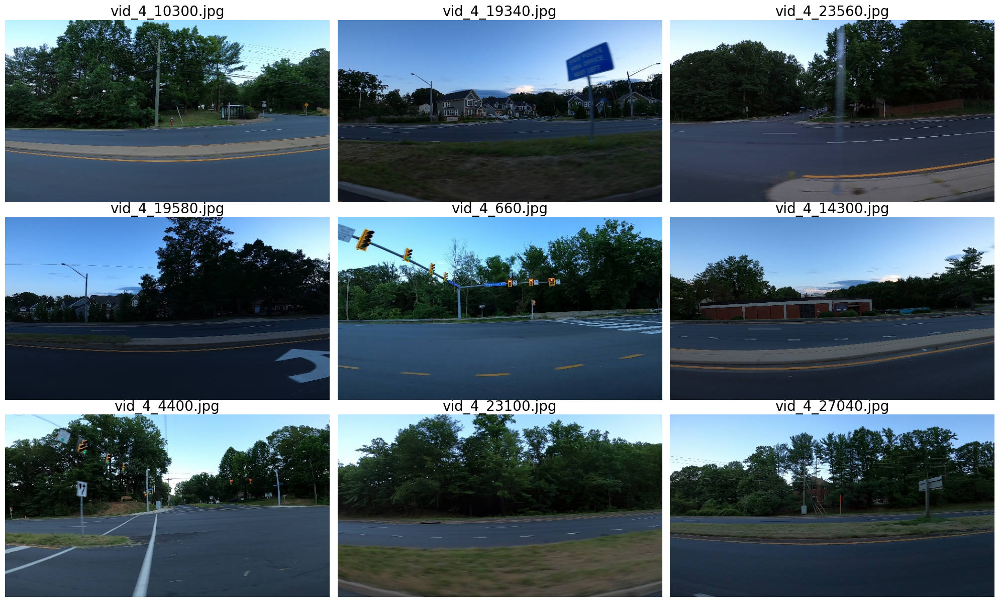

In [8]:
train_images_dir = Path("/kaggle/working/dataset/images/train")

image_files = list(train_images_dir.glob("*.jpg"))

sample_files = random.sample(image_files, min(9, len(image_files)))

fig, axes = plt.subplots(3, 3, figsize=(20, 12))
axes = axes.flatten()

for ax, img_path in zip(axes, sample_files):
    img = cv2.imread(str(img_path))                  
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)       
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(img_path.name, fontsize=20)

plt.tight_layout()
plt.show()

# Train / Val / Test Image Counts

Train Image count: 800
Test Image count: 800
Val Image count: 800


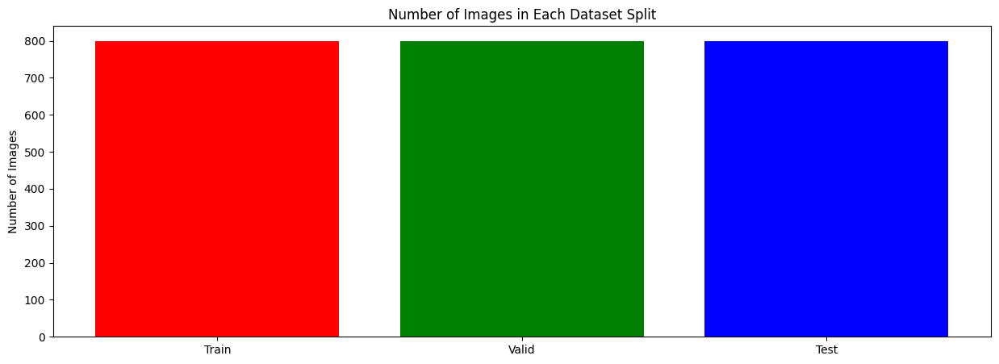

In [9]:
train_dir = Path("/kaggle/working/dataset/images/train")
valid_dir = Path("/kaggle/working/dataset/images/val")
test_dir = Path("/kaggle/input/car-object-detection/data/testing_images")

train_count = len(list(train_images_dir.glob("*.jpg")))
valid_count = len(list(train_images_dir.glob("*.jpg")))
test_count = len(list(train_images_dir.glob("*.jpg")))

print(f"Train Image count: {train_count}")
print(f"Test Image count: {test_count}")
print(f"Val Image count: {valid_count}")


plt.figure(figsize=(15,5))
plt.bar(['Train', 'Valid', 'Test'], [train_count, valid_count, test_count], color=['red', 'green', 'blue'])
plt.title('Number of Images in Each Dataset Split')
plt.ylabel('Number of Images')
plt.show()

# Sample Training Images with Labels

In [10]:
def plot_with_boxes(image_path,label_path):
    image = cv2.imread(image_path)
    height, width = image.shape[:2]
    
    with open(label_path, "r") as f:
        lines = f.readlines()
    
    for line in lines:
        class_id, x_center, y_center, w, h = map(float, line.strip().split())
        
        # Convert normalized coords to pixel values
        x_center *= width
        y_center *= height
        w *= width
        h *= height
    
        # Get top-left and bottom-right
        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)
    
        # Draw rectangle
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(image, f"{class_img[class_id]}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
    return image

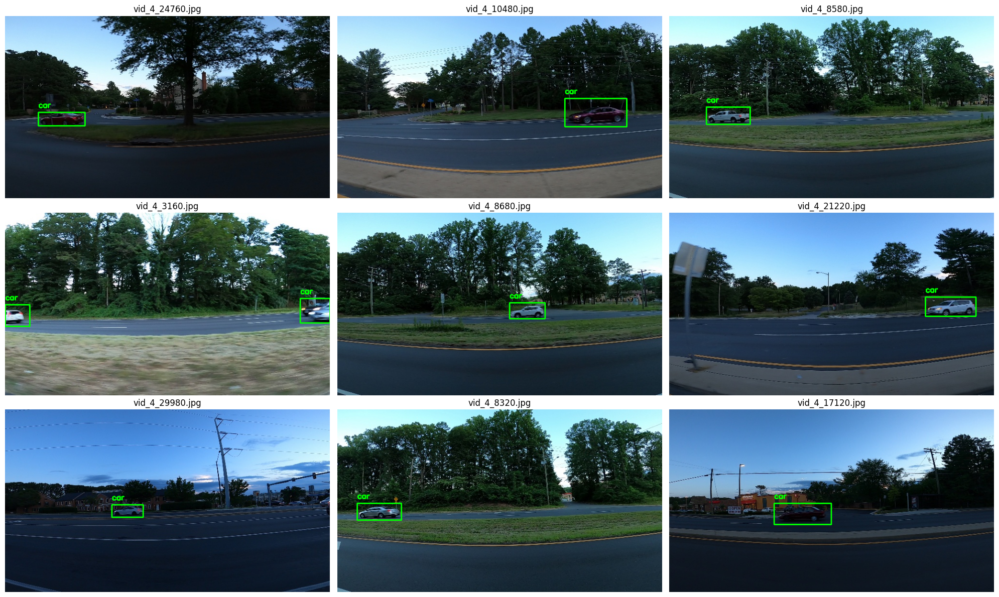

In [11]:
train_images_dir = Path("/kaggle/working/dataset/images/train")
train_label_dir = Path("/kaggle/working/dataset/labels/train")

image_files = list(train_images_dir.glob("*.jpg"))

valid_images = [img for img in image_files if (train_label_dir / f"{img.stem}.txt").exists()]

sample_files = random.sample(valid_images, min(9, len(valid_images)))

fig, axes = plt.subplots(3, 3, figsize=(20, 12))
axes = axes.flatten()

for ax, img_path in zip(axes, sample_files):
    label_path = train_label_dir / f"{img_path.stem}.txt"
    image_with_boxes = plot_with_boxes(img_path, label_path)
    image_with_boxes = cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB)
    
    ax.imshow(image_with_boxes)
    ax.axis("off")
    ax.set_title(img_path.name, fontsize=12)

plt.tight_layout()
plt.show()

# Train YOLO11s Model

In [12]:
yaml_path = "/kaggle/working/dataset.yaml"

model = YOLO("yolo11s.pt")

model.info()

results = model.train(
    data=yaml_path, 
    epochs=50, 
    batch=8, 
    imgsz=640,
    workers=5,
    lr0=0.001,  # 0.0001 is a bit low, 0.001 might allow faster learning
    lrf=0.01,  # To reduce the final learning rate
    seed=0,
    dropout=0.2,
    iou=0.6,  # IoU threshold for NMS,
    optimizer='SGD',  # Use SGD for better generalization # auto
)

YOLO11s summary: 181 layers, 9,458,752 parameters, 0 gradients
Ultralytics 8.3.217 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/dataset.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.2, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.6, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overla

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        201        104       0.98      0.981      0.994       0.71
Speed: 0.1ms preprocess, 2.9ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to /kaggle/working/runs/detect/train


In [13]:
metrics = model.val()

Ultralytics 8.3.217 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1269.1±867.3 MB/s, size: 92.0 KB)
val: Scanning /kaggle/working/dataset/labels/val.cache... 71 images, 130 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 201/201 358.4Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 13/13 6.9it/s 1.9s


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        201        104       0.98      0.981      0.994      0.705
Speed: 1.4ms preprocess, 5.3ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/runs/detect/val


In [14]:
# Save the trained model
model.save('yolov11_trained.pt')
print("Model trained and saved successfully!")

Model trained and saved successfully!


In [15]:
# Define the path to the directory
#post_training_files_path ='/kaggle/working/runs/detect/train2'
post_training_files_path ='/kaggle/working/runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 results.csv	      val_batch0_labels.jpg
BoxF1_curve.png			 results.png	      val_batch0_pred.jpg
BoxP_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
BoxPR_curve.png			 train_batch1.jpg     val_batch1_pred.jpg
BoxR_curve.png			 train_batch2.jpg     val_batch2_labels.jpg
confusion_matrix_normalized.png  train_batch4000.jpg  val_batch2_pred.jpg
confusion_matrix.png		 train_batch4001.jpg  weights
labels.jpg			 train_batch4002.jpg


# After trained detect images

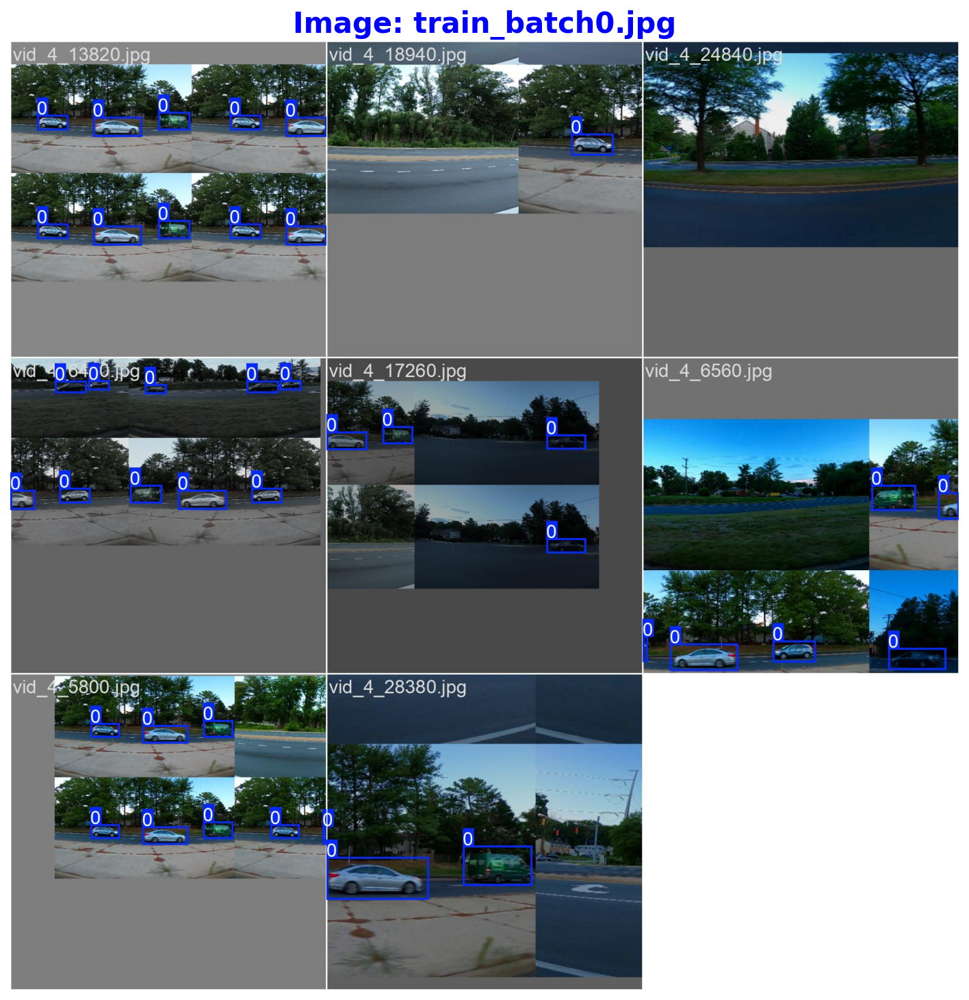

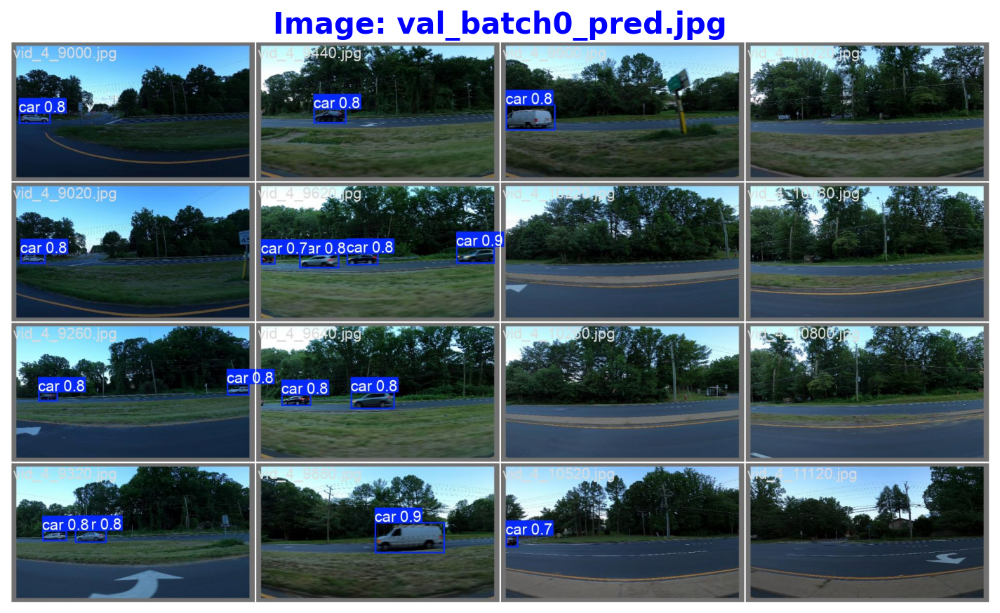

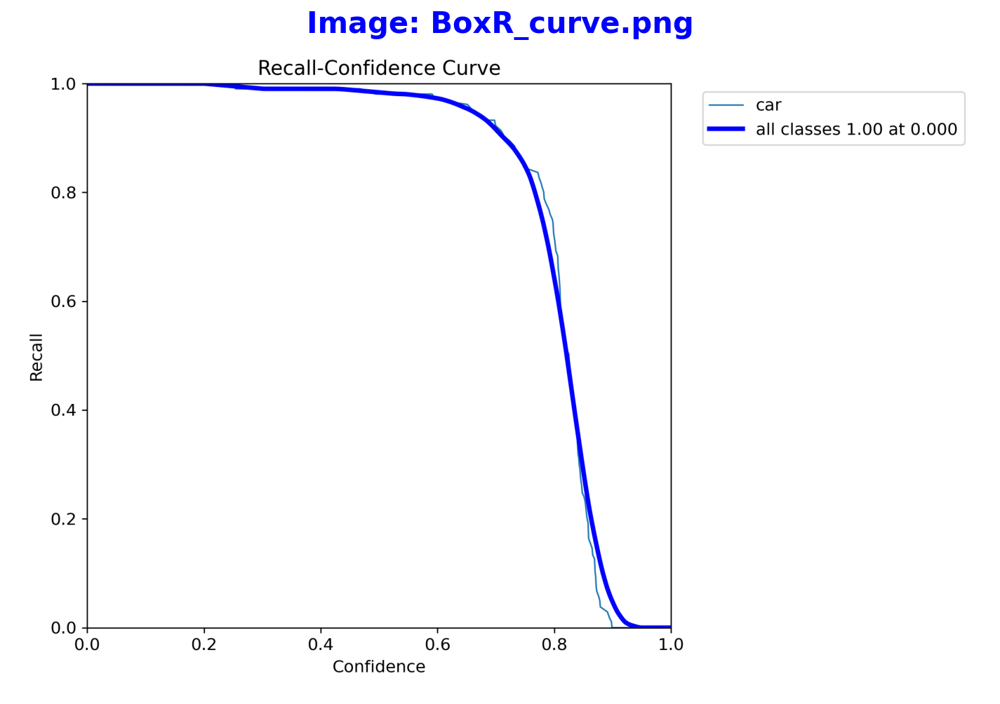

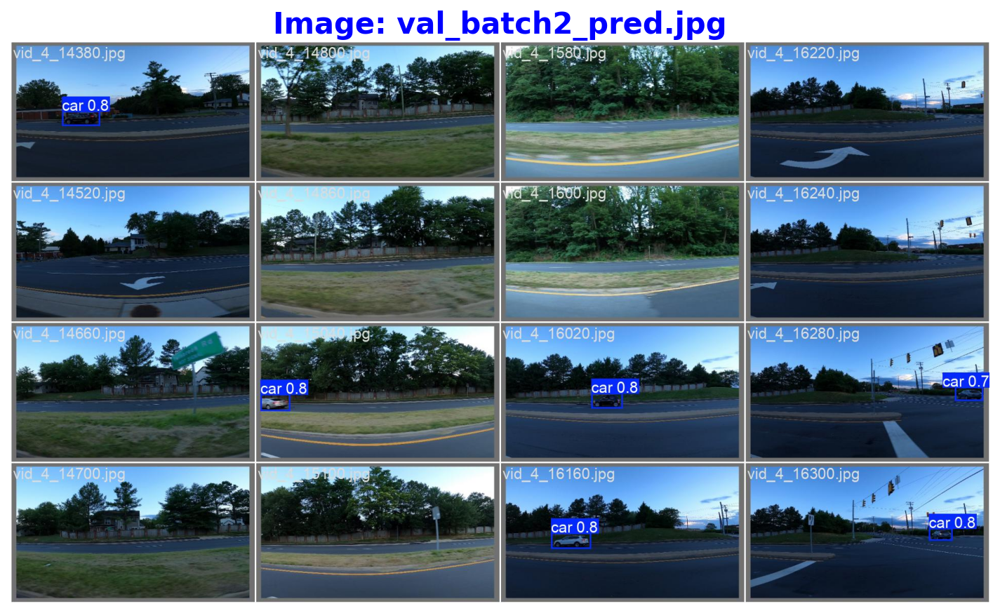

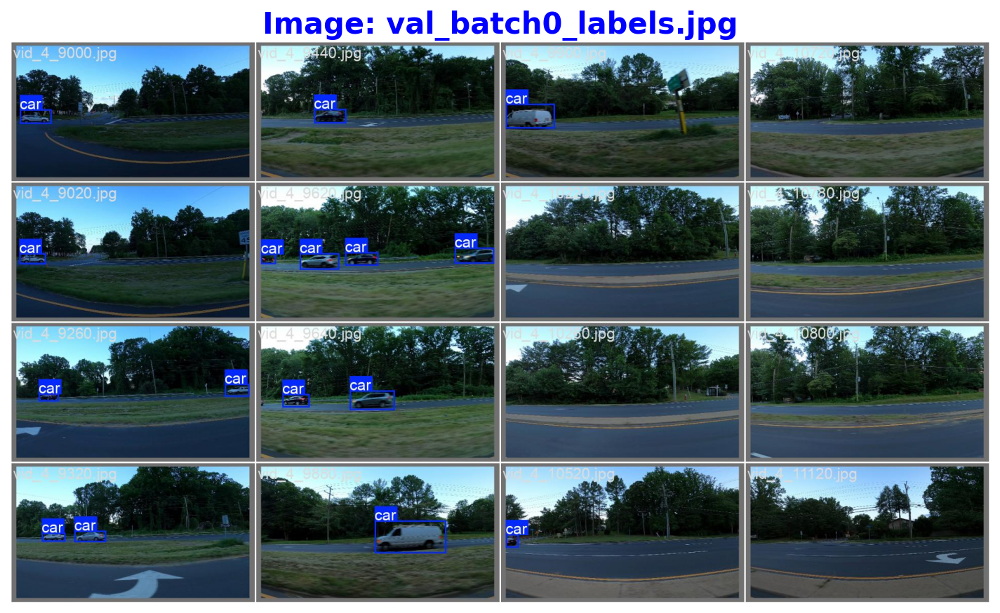

...

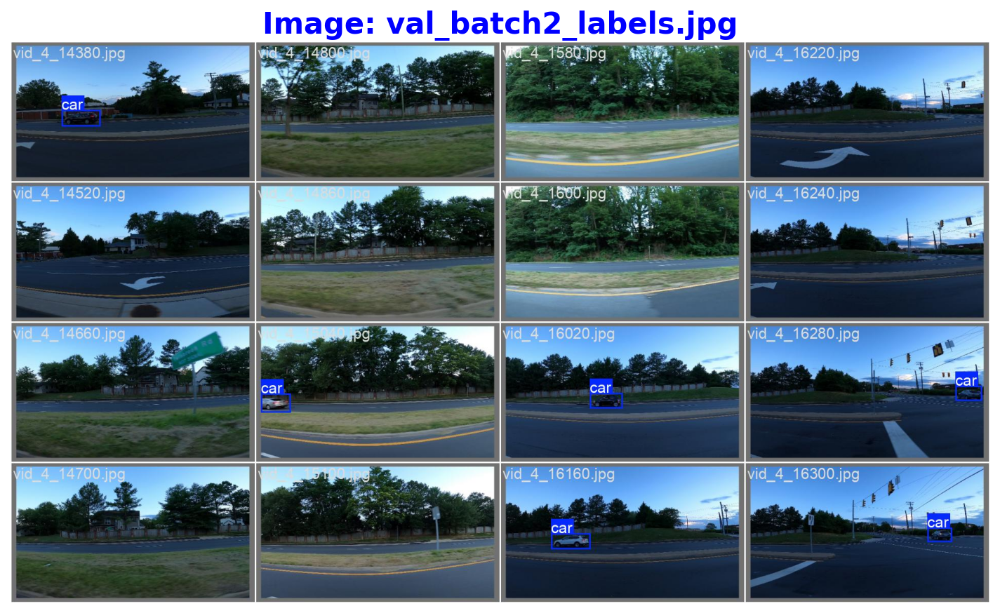

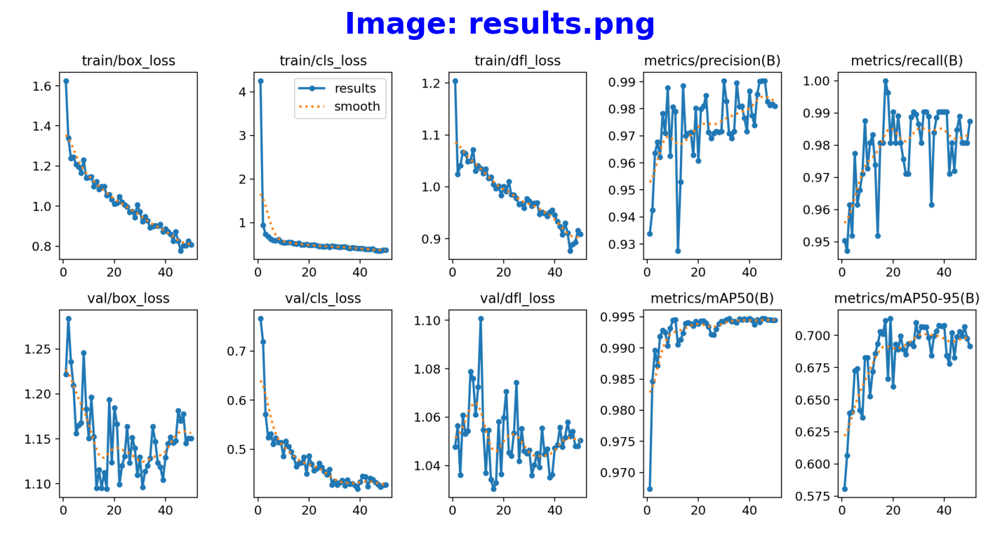

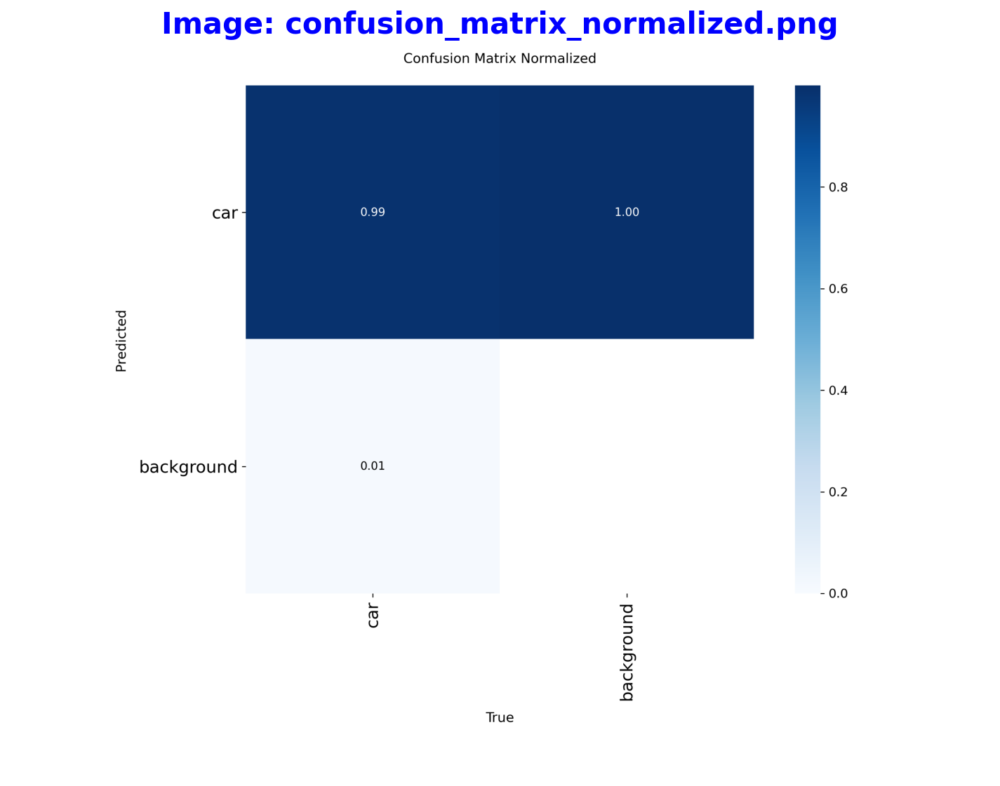

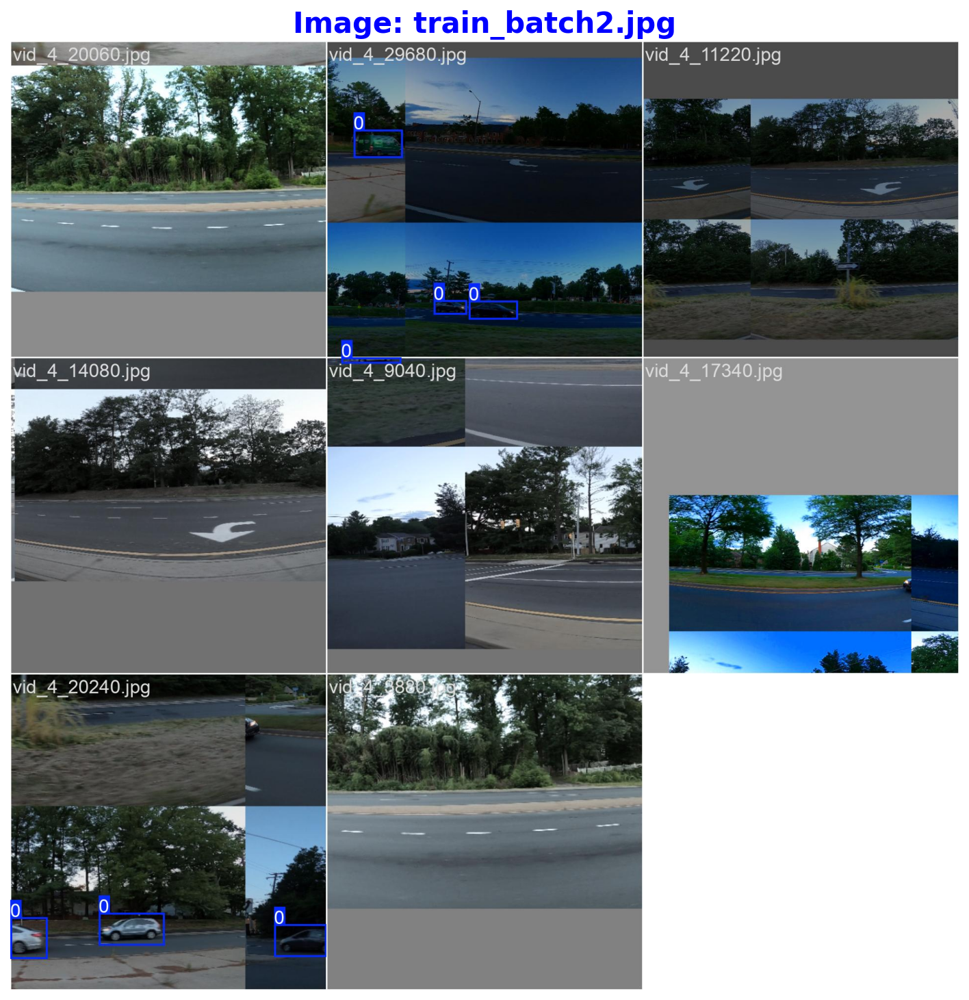

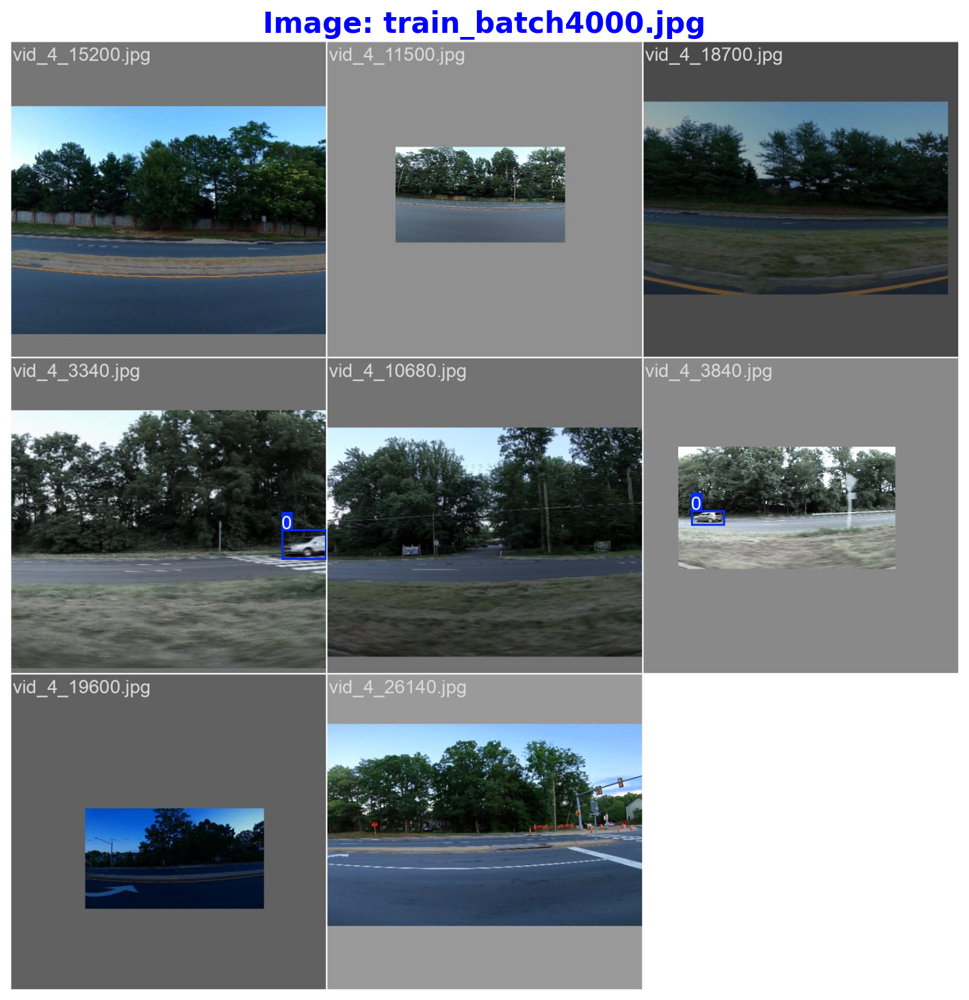

In [16]:
# Define the path to the directory containing the images
#image_directory = "/kaggle/working/runs/detect/train2"
image_directory ='/kaggle/working/runs/detect/train'

# Iterate through all image files in the directory
for filename in os.listdir(image_directory):
    if filename.lower().endswith((".jpg",".png")):
        image_path = os.path.join(image_directory, filename)
        image = Image.open(image_path)

        # Display the image
        plt.figure(figsize=(12, 12), dpi=150)
        plt.imshow(image)
        plt.title(f"Image: {filename}", fontsize=20, fontweight='bold', color='blue')  # Customize font properties
        plt.axis("off")  # Hide axes
        plt.show()

📂 Files in directory: ['train_batch0.jpg', 'val_batch0_pred.jpg', 'BoxR_curve.png', 'val_batch2_pred.jpg', 'val_batch0_labels.jpg', 'BoxP_curve.png', 'train_batch4002.jpg', 'confusion_matrix.png', 'BoxPR_curve.png', 'BoxF1_curve.png', 'val_batch1_labels.jpg', 'val_batch1_pred.jpg', 'labels.jpg', 'args.yaml', 'train_batch1.jpg', 'train_batch4001.jpg', 'val_batch2_labels.jpg', 'weights', 'results.png', 'results.csv', 'confusion_matrix_normalized.png', 'train_batch2.jpg', 'train_batch4000.jpg']

🔍 Attempting to display images...



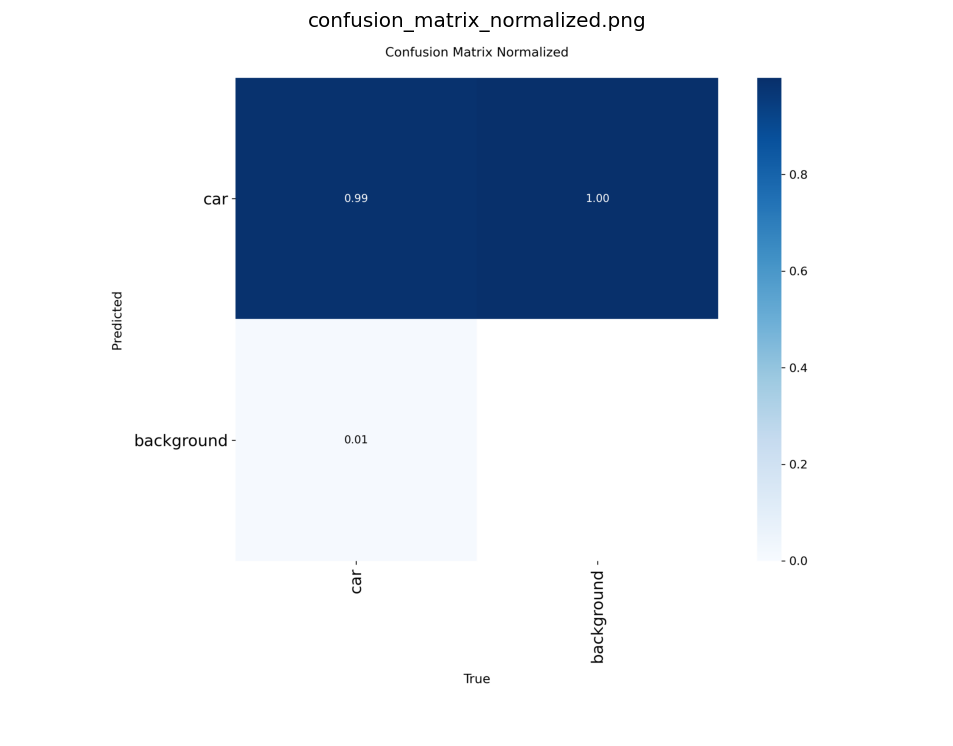

⚠️ Warning: Could not read image 'F1_curve.png'. Check if the file exists and is a valid image.

⚠️ Warning: Could not read image 'P_curve.png'. Check if the file exists and is a valid image.

⚠️ Warning: Could not read image 'R_curve.png'. Check if the file exists and is a valid image.

⚠️ Warning: Could not read image 'PR_curve.png'. Check if the file exists and is a valid image.



[ WARN:0@836.329] global loadsave.cpp:275 findDecoder imread_('/kaggle/working/runs/detect/train/F1_curve.png'): can't open/read file: check file path/integrity
[ WARN:0@836.329] global loadsave.cpp:275 findDecoder imread_('/kaggle/working/runs/detect/train/P_curve.png'): can't open/read file: check file path/integrity
[ WARN:0@836.330] global loadsave.cpp:275 findDecoder imread_('/kaggle/working/runs/detect/train/R_curve.png'): can't open/read file: check file path/integrity
[ WARN:0@836.330] global loadsave.cpp:275 findDecoder imread_('/kaggle/working/runs/detect/train/PR_curve.png'): can't open/read file: check file path/integrity


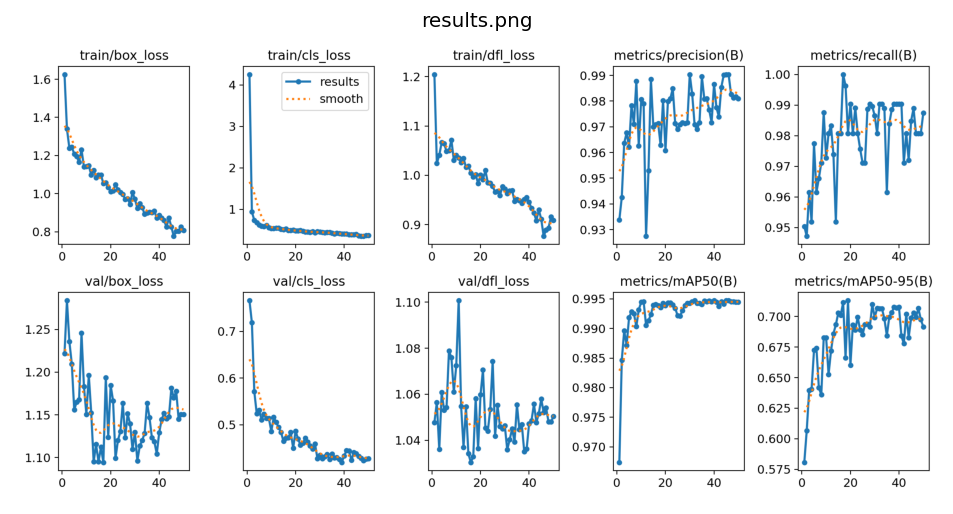

In [17]:
import os
import cv2
import matplotlib.pyplot as plt

def display_images(post_training_files_path, image_files):
    # Print all files in the directory to help debug missing files
    print("📂 Files in directory:", os.listdir(post_training_files_path))
    print("\n🔍 Attempting to display images...\n")

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)

        if img is None:
            print(f"⚠️ Warning: Could not read image '{image_file}'. Check if the file exists and is a valid image.\n")
            continue

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.title(image_file)
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = '/kaggle/working/runs/detect/train'

# Display the images
display_images(post_training_files_path, image_files)

In [18]:
Result_Final_model = pd.read_csv('/kaggle/working/runs/detect/train/results.csv')
Result_Final_model.tail(10)

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
40,41,625.835,0.87172,0.40966,0.93330,0.97745,0.99038,0.99443,0.68407,1.14444,0.44457,1.04855,0.000208,0.000208,0.000208
41,42,640.911,0.86033,0.38908,0.92347,0.97391,0.97115,0.99376,0.67776,1.15194,0.44428,1.05575,0.000188,0.000188,0.000188
42,43,656.045,0.82463,0.38951,0.90824,0.98538,0.98077,0.99452,0.70194,1.14564,0.42428,1.04772,0.000168,0.000168,0.000168
43,44,671.095,0.87279,0.38920,0.93015,0.99020,0.97203,0.99414,0.68268,1.14769,0.44039,1.05160,0.000149,0.000149,0.000149
44,45,686.181,0.82576,0.40368,0.91113,0.99033,0.98482,0.99471,0.69879,1.18122,0.43820,1.05789,0.000129,0.000129,0.000129
45,46,701.235,0.77647,0.36374,0.87654,0.99037,0.98891,0.99471,0.70283,1.17002,0.43230,1.05213,0.000109,0.000109,0.000109
46,47,716.304,0.80342,0.35804,0.88946,0.98268,0.98077,0.99452,0.69947,1.17778,0.42812,1.05408,0.000089,0.000089,0.000089
47,48,731.322,0.80401,0.35245,0.89340,0.98124,0.98077,0.99452,0.70658,1.14518,0.42344,1.04801,0.000069,0.000069,0.000069
48,49,746.439,0.82582,0.36868,0.91576,0.98175,0.98077,0.99442,0.69741,1.15048,0.42690,1.04793,0.000050,0.000050,0.000050
49,50,761.535,0.80676,0.36876,0.90878,0.98090,0.98738,0.99442,0.69165,1.15062,0.42790,1.05031,0.000030,0.000030,0.000030


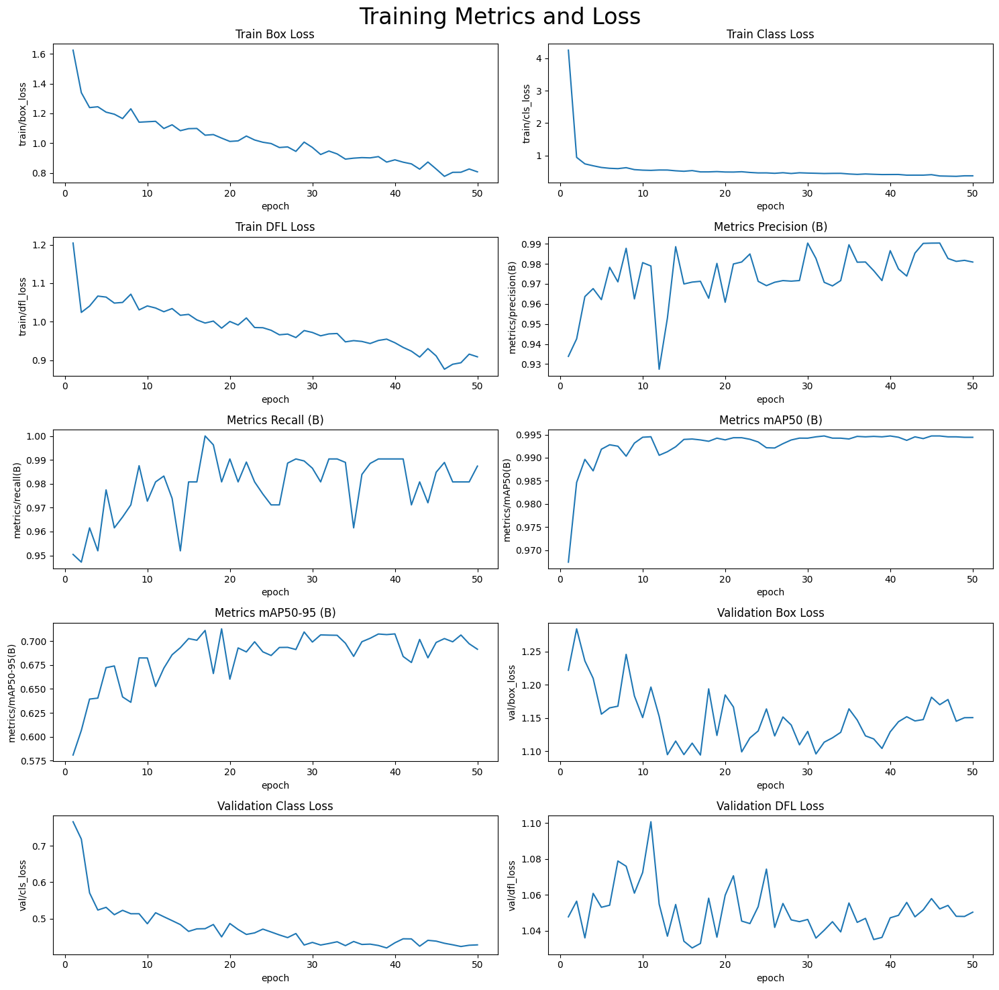

In [19]:
# Read the results.csv file as a pandas dataframe,
Result_Final_model.columns = Result_Final_model.columns.str.strip()

# Create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# Plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=Result_Final_model, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=Result_Final_model, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=Result_Final_model, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=Result_Final_model, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=Result_Final_model, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=Result_Final_model, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=Result_Final_model, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=Result_Final_model, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=Result_Final_model, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=Result_Final_model, ax=axs[4,1])

# Set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')


plt.suptitle('Training Metrics and Loss', fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()

In [20]:
# Loading the best performing model
Valid_model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

# Evaluating the model on the validset
metrics = Valid_model.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.217 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2347.5±548.6 MB/s, size: 92.1 KB)
val: Scanning /kaggle/working/dataset/labels/val.cache... 71 images, 130 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 201/201 416.1Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 13/13 6.7it/s 1.9s


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        201        104       0.98      0.981      0.994      0.705
Speed: 1.3ms preprocess, 5.3ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /kaggle/working/runs/detect/val2
precision(B):  0.980369884604182
metrics/recall(B):  0.9807692307692307
metrics/mAP50(B):  0.9942315442388715
metrics/mAP50-95(B):  0.7054528911548982


# Test image


image 1/1 /kaggle/input/car-object-detection/data/training_images/vid_4_1000.jpg: 384x640 1 car, 54.7ms
Speed: 1.6ms preprocess, 54.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
vid_4_1000.jpg: Detected boxes count: 1

image 1/1 /kaggle/input/car-object-detection/data/training_images/vid_4_12120.jpg: 384x640 1 car, 10.8ms
Speed: 1.6ms preprocess, 10.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)
vid_4_12120.jpg: Detected boxes count: 1

image 1/1 /kaggle/input/car-object-detection/data/training_images/vid_4_14520.jpg: 384x640 (no detections), 10.8ms
Speed: 1.5ms preprocess, 10.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
vid_4_14520.jpg: Detected boxes count: 0

image 1/1 /kaggle/input/car-object-detection/data/training_images/vid_4_17220.jpg: 384x640 (no detections), 10.8ms
Speed: 1.5ms preprocess, 10.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
vid_4_17220.jpg: Detected boxes count: 0

image

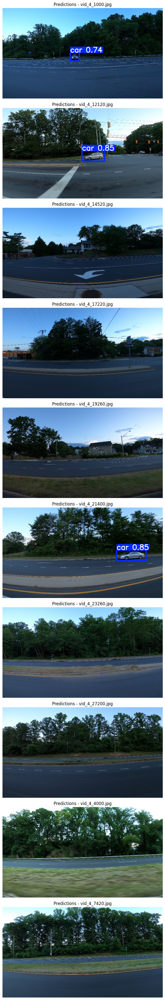

In [21]:
original_images_path = Path('/kaggle/input/car-object-detection/data/training_images')

class_names = [
    'Comminuted', 'Greenstick', 'Healthy', 'Linear', 'Oblique Displaced',
    'Oblique', 'Segmental', 'Spiral', 'Transverse Displaced', 'Transverse'
]

image_files = sorted([f for f in original_images_path.iterdir() if f.suffix.lower() == '.jpg'])

step = max(1, len(image_files) // 10)
selected_images = image_files[::step][:10]

rows = len(selected_images)
fig, axes = plt.subplots(rows, 1, figsize=(10, rows * 4))

test_model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")

for i, img_path in enumerate(selected_images):
    results = test_model.predict(source=str(img_path), imgsz=640, conf=0.5)
    print(f"{img_path.name}: Detected boxes count: {len(results[0].boxes)}")

    pred_annotated = results[0].plot(line_width=3)
    pred_annotated_rgb = cv2.cvtColor(pred_annotated, cv2.COLOR_BGR2RGB)

    axes[i].imshow(pred_annotated_rgb)
    axes[i].set_title(f"Predictions - {img_path.name}", fontsize=12)
    axes[i].axis('off')

plt.tight_layout()
plt.show()